# K-Means

## Teoria

### Algoritmos não supervisionados

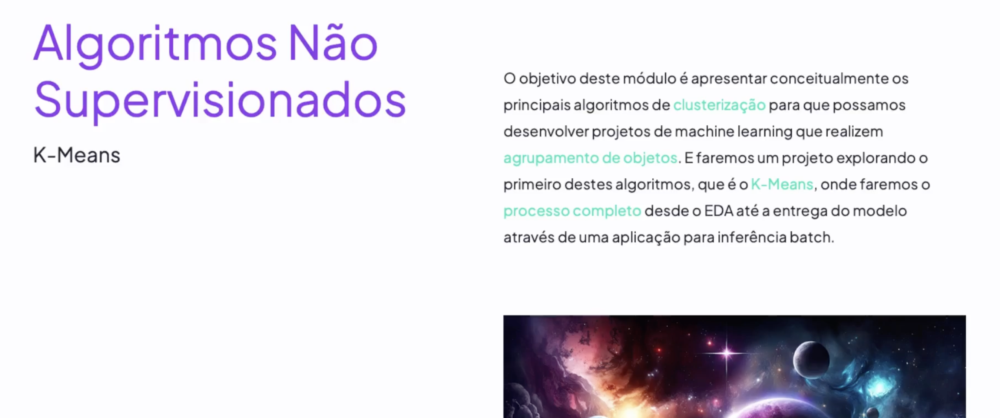

### Clusterização

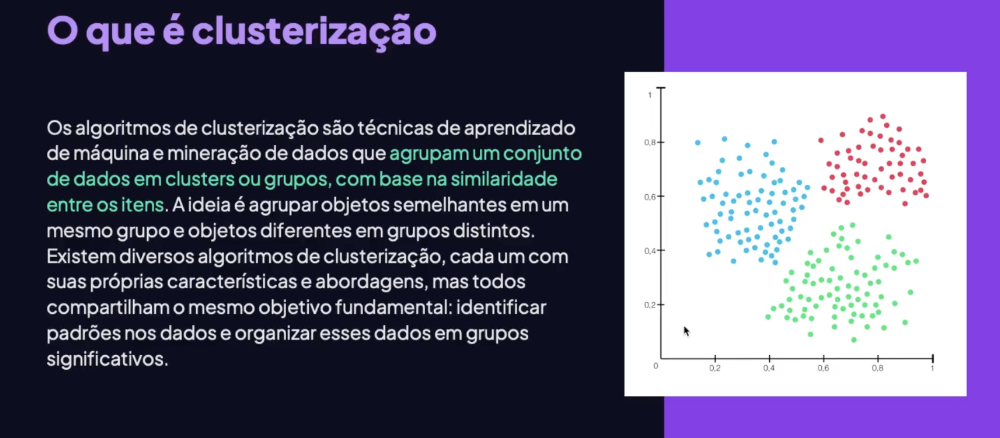

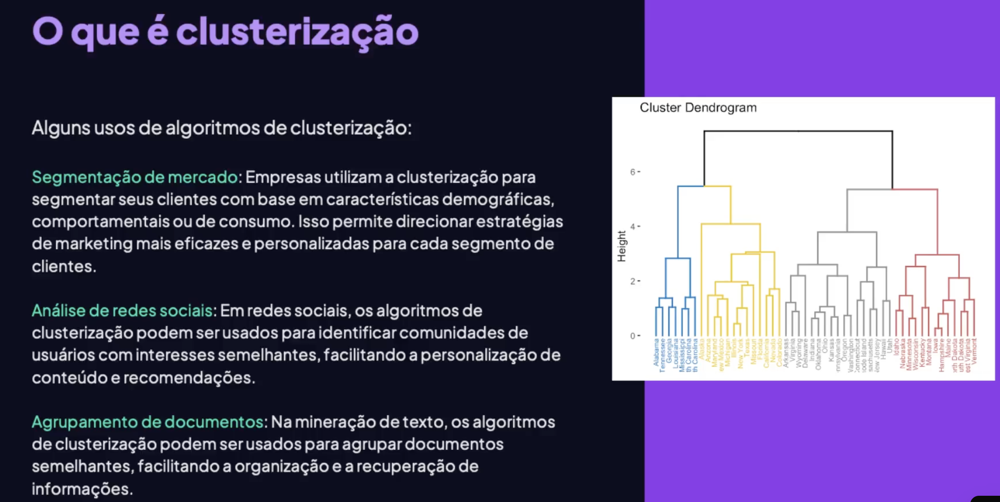

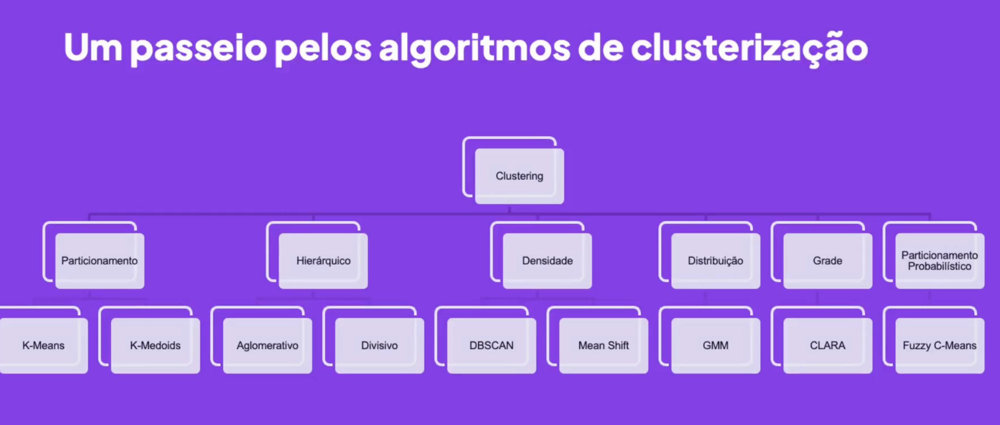

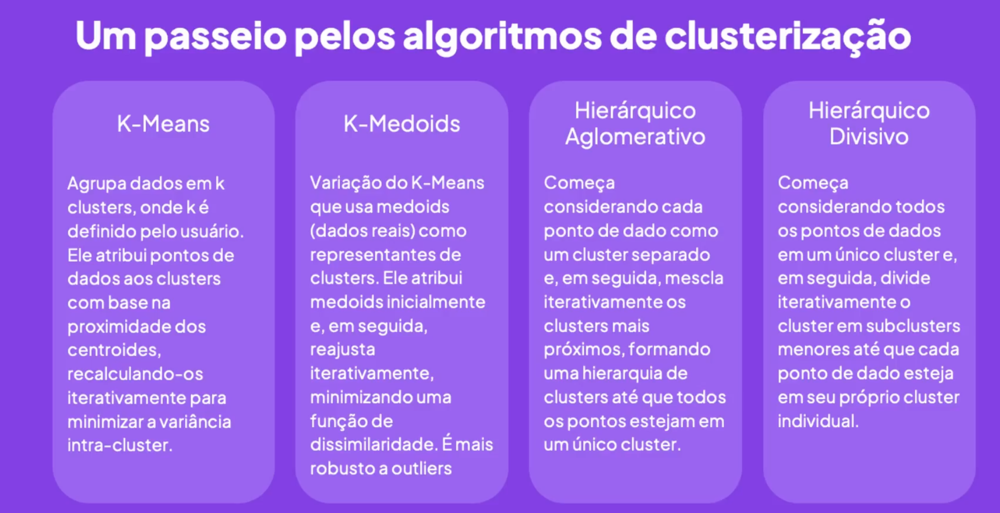

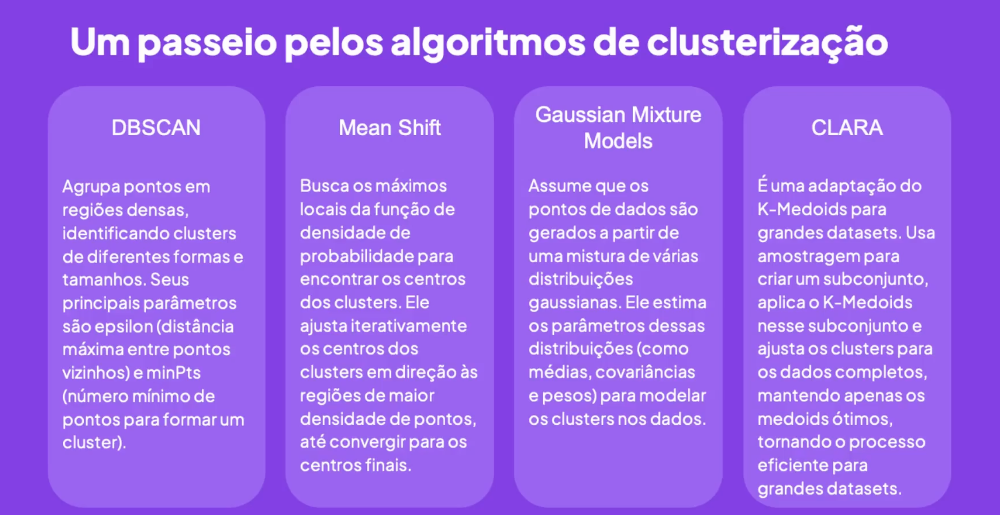

### O que é K-Means

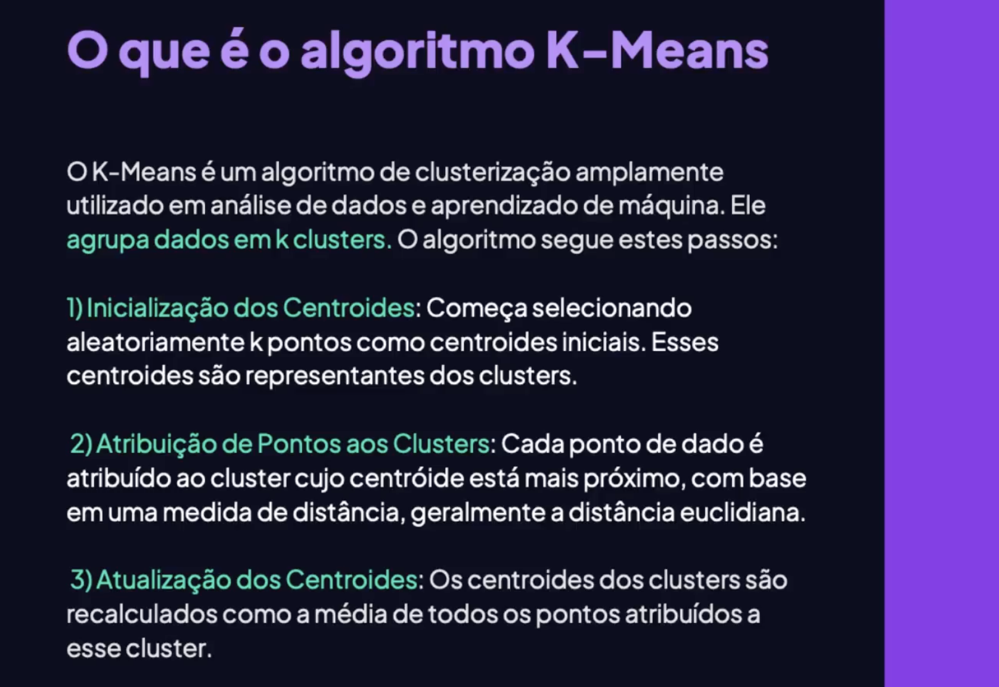

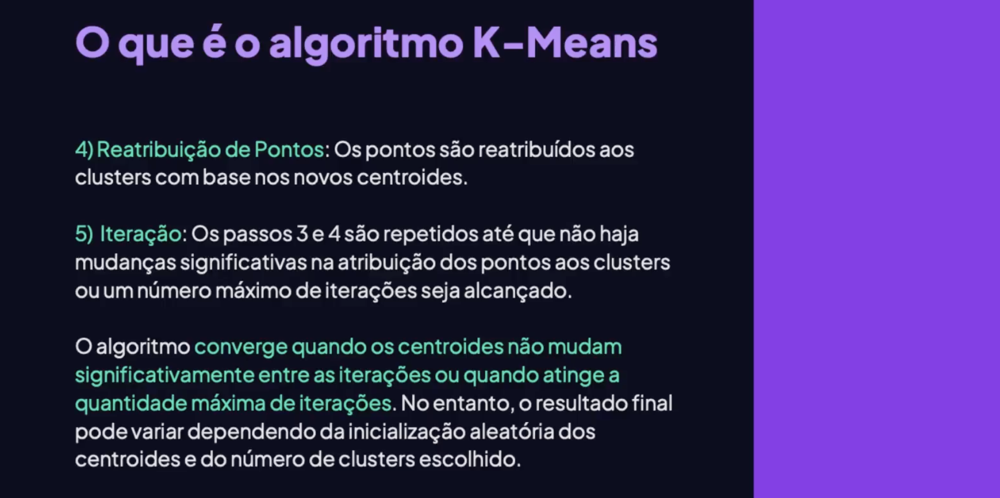

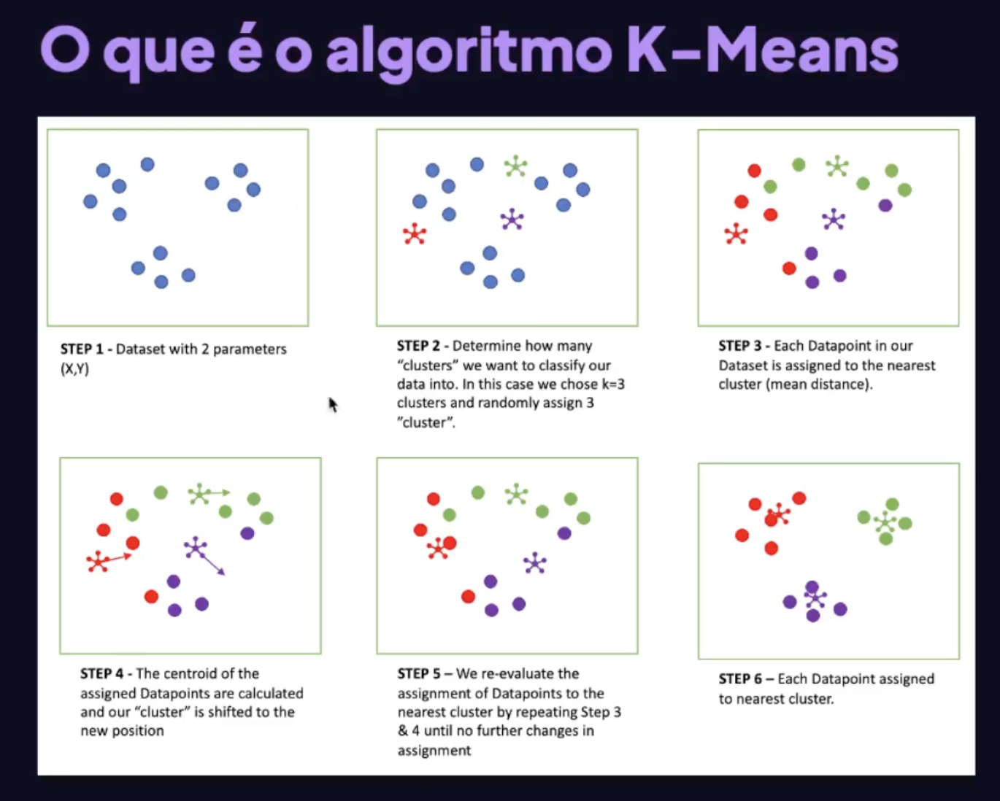

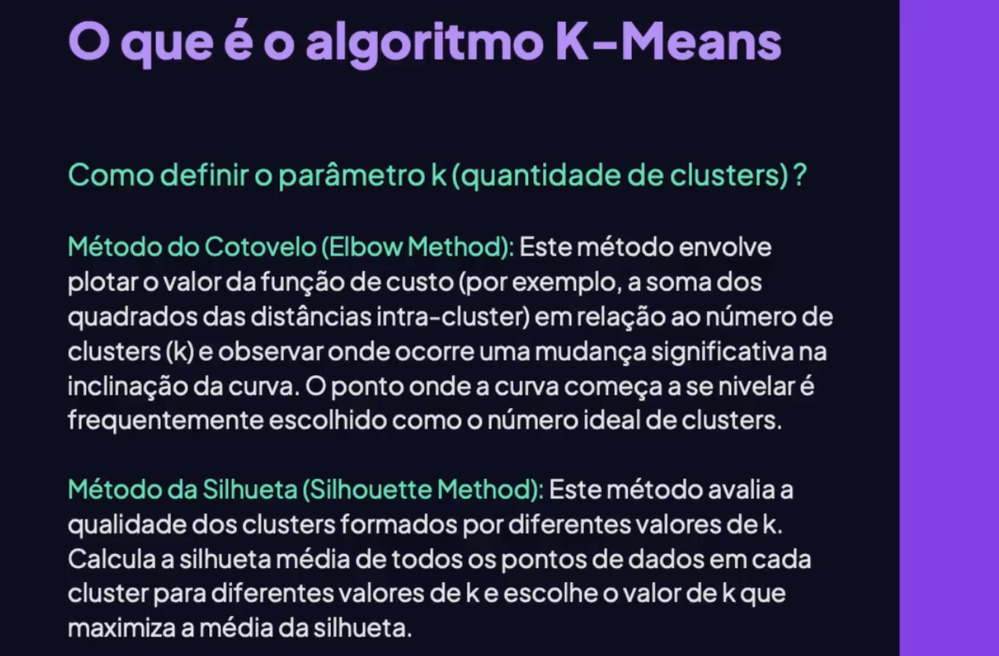

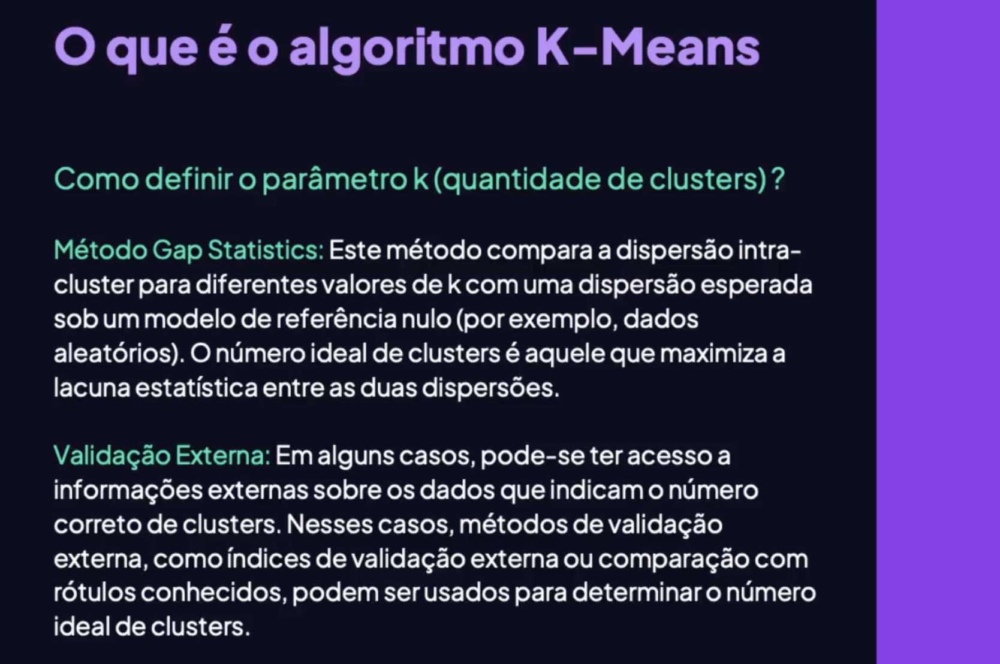

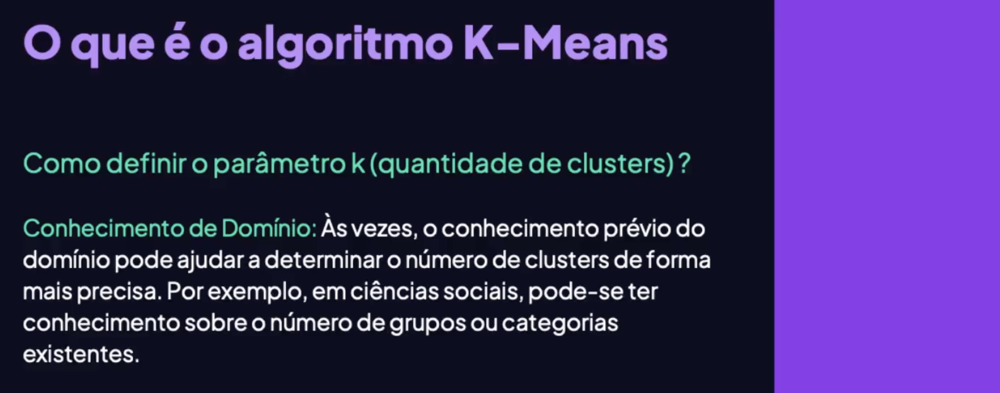

### Medidas de distância

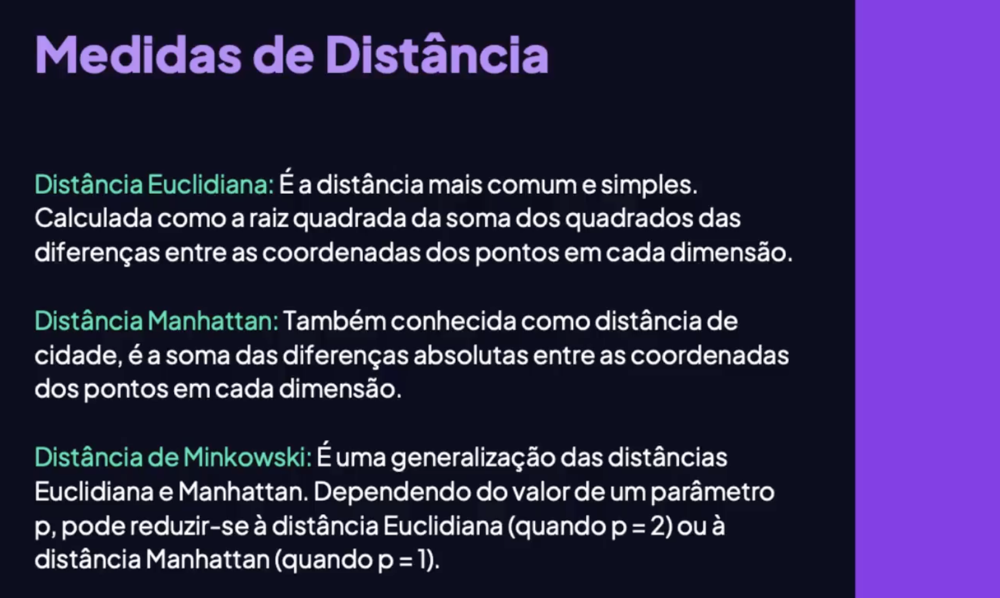

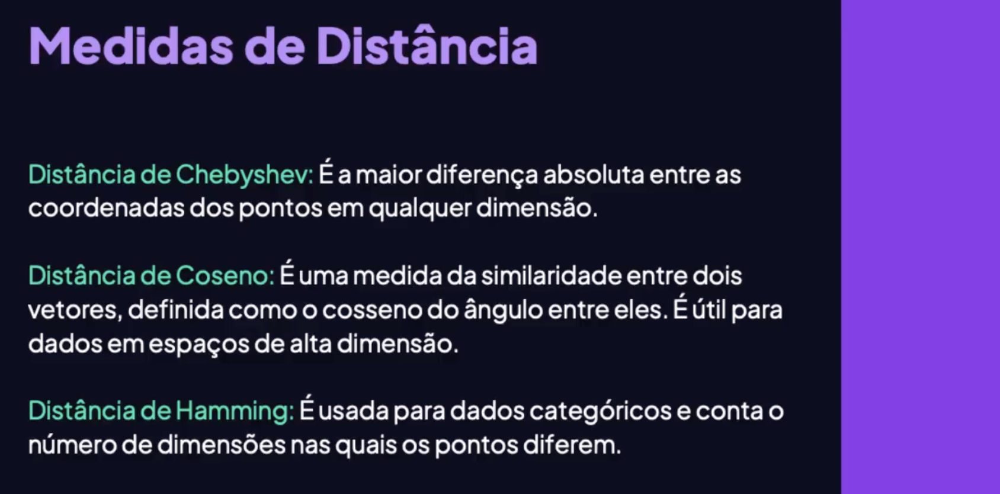

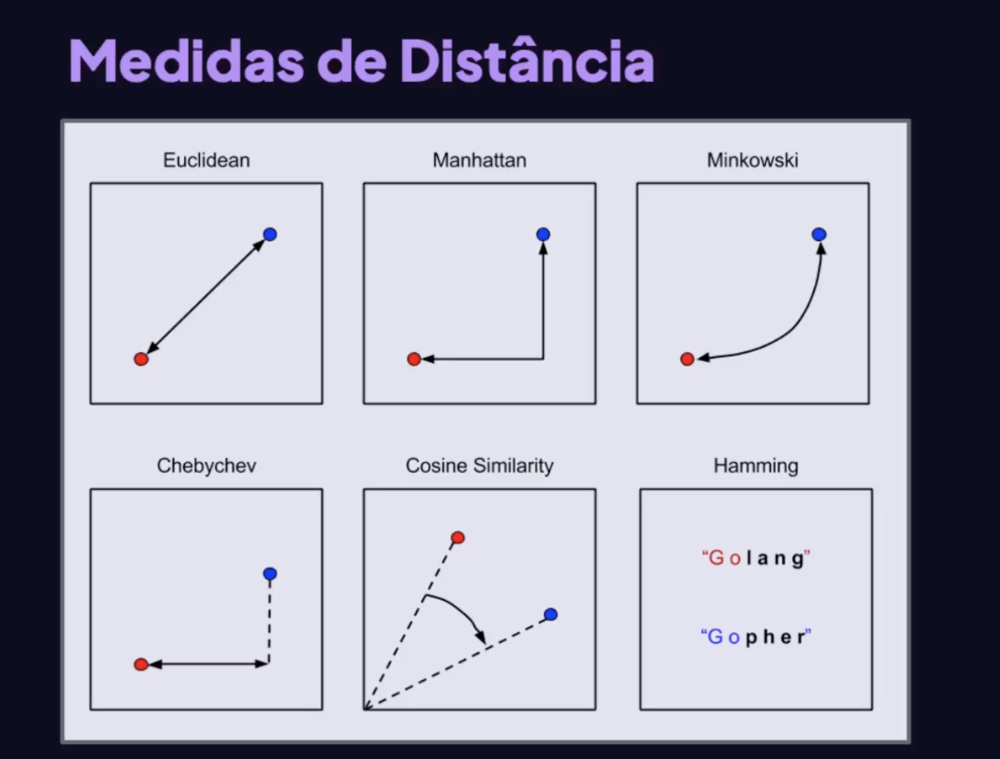

### Métricas de algoritmos

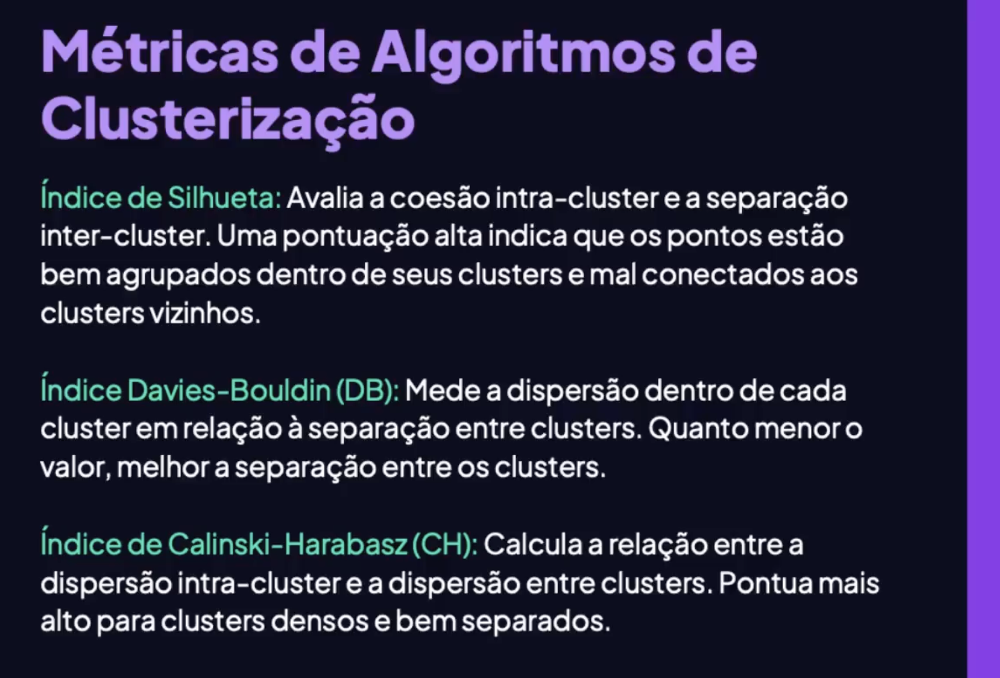

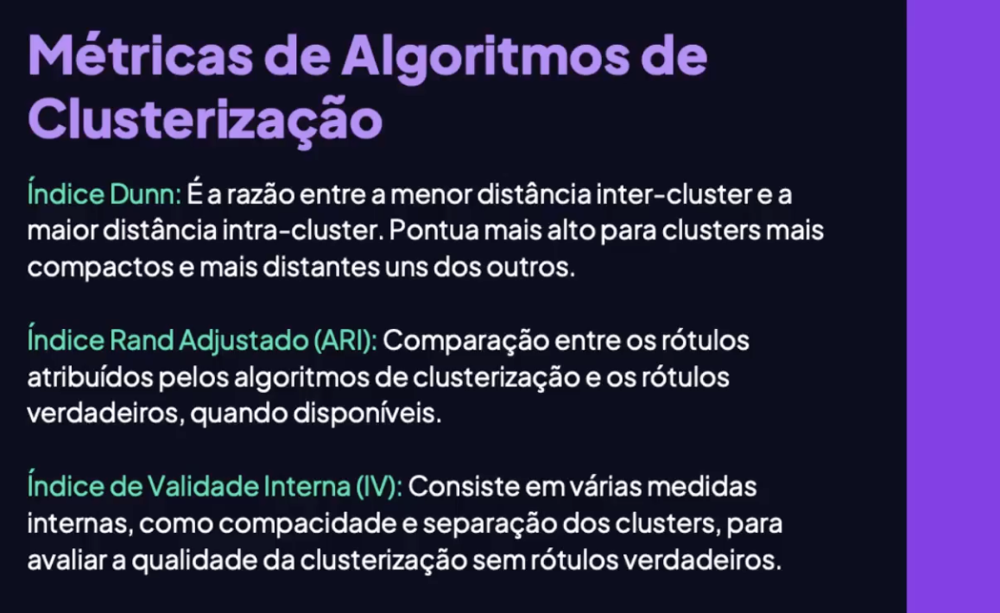

## Projeto

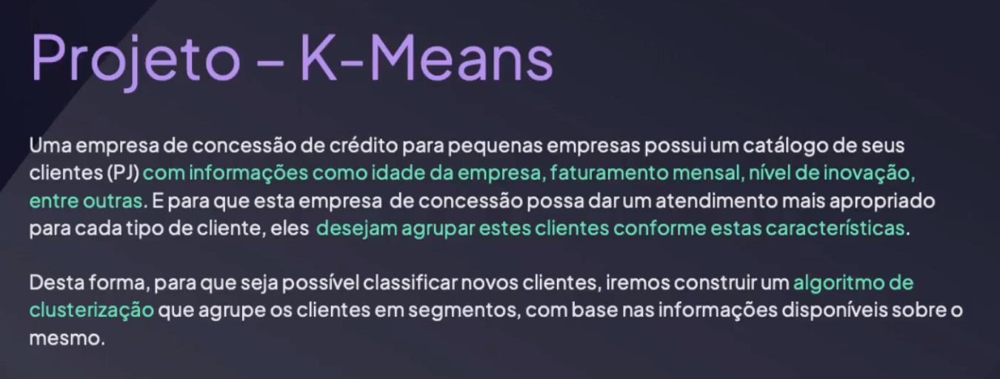

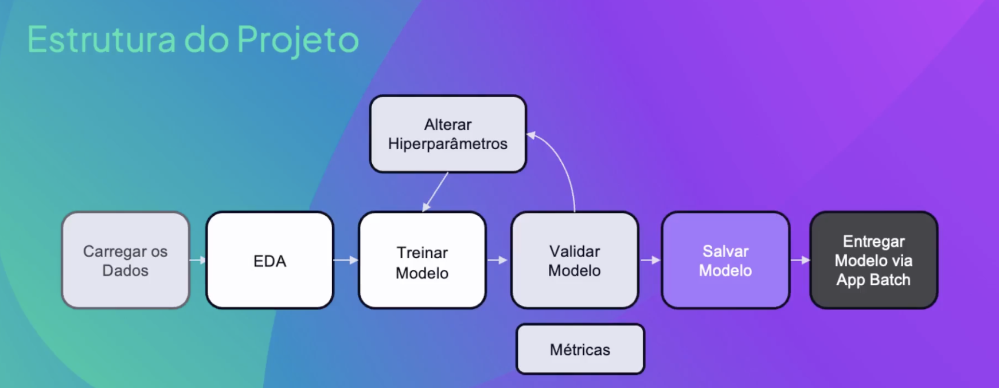

## Importações

`pipenv install pandas plotly scikit-learn optuna ipywidgets ipykernel nbformat matplotlib pingouin==0.5.5 gradio -d --python 3.9`

In [1]:
import pandas as pd
import plotly.express as px
pd.set_option('display.float_format', lambda x: '%.3f' % x)

# ML
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, pairwise_distances
from sklearn.preprocessing import StandardScaler, OneHotEncoder, OrdinalEncoder
from sklearn.compose import ColumnTransformer

# Optimização
import optuna

## Carga de dados

In [2]:
# Leitura dos dados
df_clients = pd.read_csv('./dataset/clientes_pj.csv')

In [3]:
# Visualização dos 10 primeiros registros
df_clients.head(10)

,atividade_economica,faturamento_mensal,numero_de_funcionarios,localizacao,idade,inovacao
0,Comércio,713109.950,12,Rio de Janeiro,6,1
1,Comércio,790714.380,9,São Paulo,15,0
2,Comércio,1197239.330,17,São Paulo,4,9
3,Indústria,449185.780,15,São Paulo,6,0
4,Agronegócio,1006373.160,15,São Paulo,15,8
5,Serviços,1629562.410,16,Rio de Janeiro,11,4
6,Serviços,771179.950,13,Vitória,0,1
7,Serviços,707837.610,16,São Paulo,10,6
8,Comércio,888983.660,17,Belo Horizonte,10,1
9,Indústria,1098512.640,13,Rio de Janeiro,9,3


In [4]:
# Visualizar estrutura do dataset
df_clients.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500 entries, 0 to 499
Data columns (total 6 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   atividade_economica     500 non-null    object 
 1   faturamento_mensal      500 non-null    float64
 2   numero_de_funcionarios  500 non-null    int64  
 3   localizacao             500 non-null    object 
 4   idade                   500 non-null    int64  
 5   inovacao                500 non-null    int64  
dtypes: float64(1), int64(3), object(2)
memory usage: 23.6+ KB


## EDA

In [5]:
# Distribuição da variável inovação
percentual_inovacao = df_clients.value_counts('inovacao') / len(df_clients) * 100 
px.bar(percentual_inovacao, title='Distribuição da variável inovação',color=percentual_inovacao.index)

In [ ]:
# Teste de hipótese ANOVA - Análise de variância
# Verifica se há variações significativas na média de faturamento mensal para diferentes níveis de inovação
# Pressupostos da ANOVA:
# - Independência das observações
# - Variável dependente é contínua
# - Segue distribuição normal
# - Homogeneidade das variâncias
# - Amostras sejam de tamanho igual

In [ ]:
# Checar se as variancias (faturamento) entre os grupos (inovação) são homogêneas
# Aplicar teste de Bartlett
# H0: As variâncias são homogêneas
# H1: As variâncias não são homogêneas
from scipy.stats import bartlett

# Separando os dados de faturamento em grupos com base na coluna de inovação
dados_agrupados = [df_clients['faturamento_mensal'][df_clients['inovacao'] == grupo] for grupo in df_clients['inovacao'].unique()]

# Executar o teste de Bartlett
bartlett_test_statistic, bartlett_p_value = bartlett(*dados_agrupados)

# Imprimir os resultados
print(f"Estatística de teste de Bartlett: {bartlett_test_statistic}")
print(f"Valor-p do teste de Bartlett: {bartlett_p_value}")

Estatística de teste de Bartlett: 10.901203117231173
Valor-p do teste de Bartlett: 0.2825418295490583


Como o p_value foi maior que 0,05, isso indica que aceitamos a hipótese nula, indicando que o df possui uma homogeniedade da varíavel faturamento entre os grupos de inovação

In [8]:
# Executar teste de normalidade - shapiro-wilk
# Verificar se os dados seguem uma distribuição normal
# H0: Segue uma distribuição normal
# H1: Não segue uma distribuição normal
from scipy.stats import shapiro

# Executar o teste de Shapiro-Wilk
shapiro_test_statistic, shapiro_p_value = shapiro(df_clients['faturamento_mensal'])

# Imprimir os resultados
print(f"Estatística de teste de Shapiro-Wilk: {shapiro_test_statistic}")
print(f"Valor-p do teste de Shapiro-Wilk: {shapiro_p_value}")

Estatística de teste de Shapiro-Wilk: 0.9959857602472714
Valor-p do teste de Shapiro-Wilk: 0.2351345103439314


Como o p_value foi maior que 0,05, isso indica que aceitamos a hipótese nula, indicando que o df segue uma distribuição normal

In [9]:
# Realizar teste de ANOVA de Welch, pois as amostras são de tamanhos diferentes
# H0: Não há diferença significativa na média de faturamento mensal entre os níveis de inovação (São iguais)
# H1: Há diferença significativa na média de faturamento mensal entre os níveis de inovação (Não são iguais)
from pingouin import welch_anova

aov = welch_anova(dv='faturamento_mensal', between='inovacao', data=df_clients)

# Exibir os resultados
print(f"Estatística de teste de ANOVA de welch: {aov.loc[0, 'F']}")
print(f"Valor-p do teste de ANOVA de welch: {aov.loc[0, 'p-unc']}")

Estatística de teste de ANOVA de welch: 1.126983619406169
Valor-p do teste de ANOVA de welch: 0.34526211273912644


Como o p_value foi maior que 0,05, isso indica que aceitamos a hipótese nula, indicando que não há diferenças significativas na média de faturamento entre os grupos de inovação

## Treinar Algoritmo K-Means

In [10]:
# Selecionar as colunas para clusterização
X = df_clients.copy()

# Separando variveis categóricas, numéricas e ordinais
numerical_features = ['faturamento_mensal', 'numero_de_funcionarios', 'idade']
categorical_features = ['localizacao', 'atividade_economica']
ordinal_features = ['inovacao']

# Pré-processamento das variáveis
# Aplicar transformação por tipos
numeric_transformer = StandardScaler()
categorical_transformer = OneHotEncoder()
ordinal_transformer = OrdinalEncoder()

preprocessor = ColumnTransformer(
		transformers=[
				('num', numeric_transformer, numerical_features),
				('cat', categorical_transformer, categorical_features),
				('ord', ordinal_transformer, ordinal_features)
		])

# Transformar os dados
X_transformed = preprocessor.fit_transform(X)

In [11]:
X_transformed

array([[-0.74634498, -0.54179191, -1.10058849, ...,  0.        ,
         0.        ,  1.        ],
       [-0.56165548, -1.5035527 ,  1.94344851, ...,  0.        ,
         0.        ,  0.        ],
       [ 0.40582654,  1.06114274, -1.77704115, ...,  0.        ,
         0.        ,  9.        ],
       ...,
       [ 2.8196246 , -1.18296577,  0.25231684, ...,  0.        ,
         1.        ,  0.        ],
       [ 1.03321411, -0.54179191, -1.43881482, ...,  0.        ,
         0.        ,  3.        ],
       [-2.03011486, -0.22120498, -1.77704115, ...,  1.        ,
         0.        ,  9.        ]])

In [14]:
# Optuna para otimização dos hiperparametros (número de clusters)
def kmeans_objective(trial):
  # Definindo os hiperparâmetros a serem ajustados
  n_clusters = trial.suggest_int('n_clusters', 3, 10)
  distance_metric = trial.suggest_categorical('distance_metric', ['euclidean', 'minkowski'])
  
	# Criar o modelo
  model_kmeans = KMeans(n_clusters=n_clusters, random_state=51)

	# Treinar o modelo
  model_kmeans.fit(X_transformed)
  
	# Calcular o score de silhueta (Silhouette Score)
  distances = pairwise_distances(X_transformed, metric=distance_metric)
  silhouette_avg = silhouette_score(distances, model_kmeans.labels_)
  
  return silhouette_avg

In [15]:
# Criar estudo do optuna
search_space = {'n_clusters': [3, 4, 5, 6, 7, 8, 9, 10], 'distance_metric': ['euclidean', 'minkowski']}
sampler = optuna.samplers.GridSampler(search_space)

study_kmeans = optuna.create_study(direction='maximize', sampler=sampler)

# Rodar o estudo
study_kmeans.optimize(kmeans_objective, n_trials=100)

[I 2024-11-07 22:36:24,880] A new study created in memory with name: no-name-7fd67b97-5486-4a4a-a35a-0be90d32126a
[I 2024-11-07 22:36:25,117] Trial 0 finished with value: 0.3847879496502922 and parameters: {'n_clusters': 4, 'distance_metric': 'euclidean'}. Best is trial 0 with value: 0.3847879496502922.
[I 2024-11-07 22:36:25,143] Trial 1 finished with value: 0.11230048381589045 and parameters: {'n_clusters': 9, 'distance_metric': 'euclidean'}. Best is trial 0 with value: 0.3847879496502922.
[I 2024-11-07 22:36:25,154] Trial 2 finished with value: 0.4445458290999087 and parameters: {'n_clusters': 3, 'distance_metric': 'minkowski'}. Best is trial 2 with value: 0.4445458290999087.
[I 2024-11-07 22:36:25,203] Trial 3 finished with value: 0.3847879496502922 and parameters: {'n_clusters': 4, 'distance_metric': 'minkowski'}. Best is trial 2 with value: 0.4445458290999087.
[I 2024-11-07 22:36:25,249] Trial 4 finished with value: 0.14731572416665678 and parameters: {'n_clusters': 8, 'distance_

In [16]:
# Melhor configuração de hiperparâmetros
best_params = study_kmeans.best_params

# Instanciar o modelo KMeans com a melhor configuração de hiperparâmetros
model_best_kmeans = KMeans(n_clusters=best_params['n_clusters'], random_state=51)
model_best_kmeans.fit(X_transformed)

distances = pairwise_distances(X_transformed, metric=best_params['distance_metric'])
silhouette_avg = silhouette_score(distances, model_best_kmeans.labels_)

print(f'k (Número de clusters): {best_params["n_clusters"]}')
print(f'Métrica de distância: {best_params["distance_metric"]}')
print(f'Silhouette Score: {silhouette_avg}')	# Quanto mais próximo de 1, melhor

k (Número de clusters): 3
Métrica de distância: euclidean
Silhouette Score: 0.4445458290999088


In [17]:
# Criar coluna com cluster escohido
df_clients['cluster'] = model_best_kmeans.labels_

In [18]:
# Visualizar os 10 primeiros registros do dataset com a coluna de cluster
df_clients.head(10)

,atividade_economica,faturamento_mensal,numero_de_funcionarios,localizacao,idade,inovacao,cluster
0,Comércio,713109.950,12,Rio de Janeiro,6,1,0
1,Comércio,790714.380,9,São Paulo,15,0,0
2,Comércio,1197239.330,17,São Paulo,4,9,1
3,Indústria,449185.780,15,São Paulo,6,0,0
4,Agronegócio,1006373.160,15,São Paulo,15,8,1
5,Serviços,1629562.410,16,Rio de Janeiro,11,4,2
6,Serviços,771179.950,13,Vitória,0,1,0
7,Serviços,707837.610,16,São Paulo,10,6,1
8,Comércio,888983.660,17,Belo Horizonte,10,1,0
9,Indústria,1098512.640,13,Rio de Janeiro,9,3,2


## Visualizar resultados

In [19]:
# Cruzar idade e faturameto mensal com o cluster
px.scatter(df_clients, x='idade', y='faturamento_mensal', color='cluster', title='Idade x Faturamento Mensal (Cluster)')

In [21]:
# Cruzar inovacao e faturameto mensal com o cluster
px.scatter(df_clients, x='inovacao', y='faturamento_mensal', color='cluster', title='Inovação x Faturamento Mensal (Cluster)')

In [22]:
# Cruzar numero de funcionarios e faturameto mensal com o cluster
px.scatter(df_clients, x='numero_de_funcionarios', y='faturamento_mensal', color='cluster', title='Funcionários x Faturamento Mensal (Cluster)')

## Salvar o modelo e Pipeline

In [23]:
import joblib
joblib.dump( model_best_kmeans, 'kmeans_model.pkl')  # Salvar o modelo treinado

# Salvar o pré-processador
joblib.dump(preprocessor, 'pipeline_preprocessor.pkl')  # Salvar o pré-processador

['pipeline_preprocessor.pkl']

## Aplicação batch - Gradio

In [24]:
import gradio as gr

modelo = joblib.load('./kmeans_model.pkl')	# Carregar o modelo treinado
preprocessor = joblib.load('./pipeline_preprocessor.pkl')	# Carregar o pré-processador

def clustering(file):
  # Carregando o arquivo
  df_empresa = pd.read_csv(file.name)
  
	# Tranformar os dados
  X_transformed = preprocessor.fit_transform(df_empresa)
  
	# Treinar o modelo
  modelo.fit(X_transformed)
  
	# Criar a coluna cluster no df
  df_empresa['cluster'] = modelo.labels_
	
  df_empresa.to_csv('./clusters.csv', index=False)
	
  return './clusters.csv'

In [25]:
# Criar a interface
app = gr.Interface(
  clustering,
	gr.File(file_types=[".csv"]),
  "file",
)

# Rodar a aplicação
app.launch()

Running on local URL:  http://127.0.0.1:7860

To create a public link, set `share=True` in `launch()`.
